In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import os

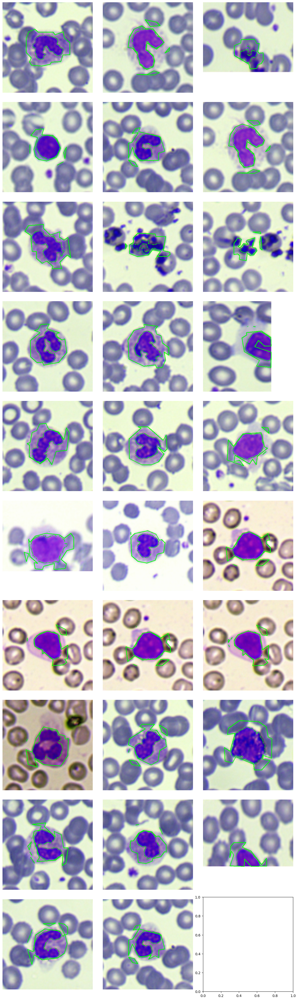

In [6]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

input_path = "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\cropped_images8"

processed_image = []
Cyto_area = []
Cyto_Perimeter = []
# Iterate over the images in the folder
for filename in os.listdir(input_path):
    if filename.endswith(".jpg"):
        image_path = os.path.join(input_path, filename)

       # Read the image
        image = cv2.imread(image_path)
        image_copy = image.copy()

        # plt.imshow(blurM)

        lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        img_hsv = cv2.cvtColor(lab, cv2.COLOR_BGR2HSV)

        # Define the lower and upper bounds for the green color in the HSV color space
        lower_green = np.array([40, 130, 170])
        upper_green = np.array([90, 255, 255])

        # Threshold the HSV image based on the color range
        img_mask = cv2.inRange(img_hsv, lower_green, upper_green)
        # plt.imshow(img_mask)
        # Find contours in the thresholded image
        contours, _ = cv2.findContours(
            img_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        def select_center_contour(contours):
            if len(contours) == 0:
                return None

            # Compute the areas of all contours
            contour_areas = [cv2.contourArea(contour) for contour in contours]

            # Find the index of the contour with the largest area
            max_area_index = np.argmax(contour_areas)

            # Return the contour with the largest area
            center_contour = contours[max_area_index]

            return center_contour
        nucleus_contour = select_center_contour(contours)
        cv2.drawContours(image_copy, nucleus_contour, -1, (0, 255, 0), 2)
        # cv2.drawContours(image_copy, nucleus_contours, -1, (0, 255, 0), 2)
        # Create a binary mask image and draw nuclei contours
        mask = np.zeros(image.shape[:2], dtype=np.uint8)
        cv2.drawContours(mask, nucleus_contour, -1, 255, thickness=cv2.FILLED)
        # Dilate the nuclei contours
        dilated_mask = cv2.dilate(mask, None, iterations=30)
        # plt.subplot(141);plt.imshow(dilated_mask)
        # Convert the image to grayscale
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        # Calculate the gradient using the Sobel operator
        gradient_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
        gradient_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)
        gradient_magnitude = cv2.magnitude(gradient_x, gradient_y)
        # Apply the mask to restrict the gradient to the cytoplasmic area
        gradient_masked = cv2.bitwise_and(
            gradient_magnitude, gradient_magnitude, mask=dilated_mask)
        # Convert the gradient image to the appropriate data type for thresholding
        gradient_masked = cv2.convertScaleAbs(gradient_masked)
        # plt.subplot(142);plt.imshow(gradient_masked,cmap="gray")

        # Threshold the gradient image
        _, thresholded = cv2.threshold(
            gradient_masked, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

        # Find contours of the cytoplasm boundary
        contours, _ = cv2.findContours(
            gradient_masked.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original image
        # cv2.drawContours(image_copy, contours, -1, (0, 255, 0), 2)
        # plt.subplot(144);plt.imshow(image_copy)
        # Display the final image in the corresponding grid cell
        pixels = image.reshape(-1, 3)
        pixels = np.float32(pixels)
        # Define the criteria for K-means clustering (maximum iterations and epsilon)
        criteria = (cv2.TERM_CRITERIA_EPS +
                    cv2.TERM_CRITERIA_MAX_ITER, 100, 0.5)

        # Perform K-means clustering
        k = 7  # Number of clusters
        _, labels, centers = cv2.kmeans(
            pixels, k, None, criteria, 100, cv2.KMEANS_RANDOM_CENTERS)

        # Convert the centers to unsigned integers
        centers = np.uint8(centers)
        # Map the labels to the centers
        segmented_image = centers[labels.flatten()]

        # Reshape the segmented image back to the original shape
        segmented_image = segmented_image.reshape(image.shape)

        # Convert the segmented image to grayscale
        segmented_image_gray = cv2.cvtColor(
            segmented_image, cv2.COLOR_RGB2GRAY)

        # Threshold the grayscale image
        _, segmented_mask = cv2.threshold(
            segmented_image_gray, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)
        # Creating kernel
        # kernel = np.ones((7, 7), np.uint8)
        # Using cv2.erode() method
        # segmented_mask = cv2.erode(segmented_mask, kernel)
        # Perform morphological operations to clean up the mask (e.g., opening, closing)
        # kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
        # segmented_mask = cv2.morphologyEx(segmented_mask, cv2.MORPH_OPEN, kernel, iterations=4)
        # segmented_mask = cv2.morphologyEx(segmented_mask, cv2.MORPH_CLOSE, kernel, iterations=2)

        # Apply the segmented mask to the original image
        segmented_result = cv2.bitwise_and(
            image_copy, image_copy, mask=segmented_mask)
        # print(mask.shape)
        # Draw the contour on the blank mask image
        contours_1, _ = cv2.findContours(
            gradient_masked.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        # print(contours)
        cv2.drawContours(mask, contours_1, -1, 255, thickness=cv2.FILLED)
        # cv2.rectangle(contour_mask, (0, 90), (200, 286), 255, -1)
        # Apply bitwise AND operation between the segmented mask and the contour mask
        contour_portion = cv2.bitwise_and(
            segmented_mask, segmented_mask, mask=mask)
        segmented_copy = segmented_result.copy()
        contours, _ = cv2.findContours(
            contour_portion, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        # contours = select_center_contour(contours)

        def smooth_contour(contour, epsilon):
            # Convert the contour to a numpy array
            contour = np.squeeze(contour)

            # Reshape the contour to fit the required format for cv2.approxPolyDP
            contour = contour.reshape((-1, 1, 2))

            # Apply the Douglas-Peucker algorithm for contour approximation
            smoothed_contour = cv2.approxPolyDP(contour, epsilon, True)

            return smoothed_contour

        contour_areas = [cv2.contourArea(contour) for contour in contours]

        # Find the index of the contour with the largest area
        max_area_index = np.argmax(contour_areas)
        # Choose the index of the contour you want to smoothen

        # Set the epsilon value for contour smoothing (adjust as needed)
        epsilon = 0.01 * cv2.arcLength(contours[max_area_index], True)
        # Smoothen the contour
        smoothed_contours = [smooth_contour(
            contour, epsilon) for contour in contours]
        # contours_center = select_center_contour(contours)
        cv2.drawContours(image_copy, smoothed_contours, -1, (0, 255, 0), 2)
        contour_areas = [cv2.contourArea(contour) for contour in contours]
        contour_perimeter = [cv2.arcLength(
            contour, True) for contour in contours]
        # Find the index of the contour with the largest area
        max_area_index = np.argmax(contour_areas)
        max_peri_index = np.argmax(contour_perimeter)
        area = contour_areas[max_area_index]
        peri = contour_perimeter[max_peri_index]
        Cyto_area.append(area)
        Cyto_Perimeter.append(peri)
        processed_image.append(image_copy)

# Create a grid for displaying the images
grid_rows = int(np.ceil(len(processed_image) / 3))
fig, axes = plt.subplots(grid_rows, 3, figsize=(12, 4 * grid_rows))

# Iterate over the processed images and display them in the grid
for i, image_x in enumerate(processed_image):
    row = i // 3
    col = i % 3
    axes[row, col].imshow(cv2.cvtColor(image_x, cv2.COLOR_BGR2RGB))
    axes[row, col].axis('off')

# Adjust the layout and display the grid
plt.tight_layout()
plt.show()

In [7]:
import pandas as pd
final_df = pd.read_csv(
    "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\final.csv", index_col=0)
final_df["Cyto_Area"] = Cyto_area
final_df["Cyto_Perimeter"] = Cyto_Perimeter

final_df = final_df.rename(
    columns={"CYTO_AREA": "CONVEX_AREA", "CYTO_PERIMETER": "CONVEX_PERIMETER"})
final_df.sort_values('Cyto_Perimeter')

,IMAGE_NAME,NUCLEUS_AREA,NUCLEUS_PERIMETER,CONVEX_AREA,CONVEX_PERIMETER,Solidity,Convexity,Circularity,Nucleus_area_upon_perimeter,Predicted Class,Confidence Score,Cyto_Area,Cyto_Perimeter
2,final_image11.jpg,2766.0,343.019332,3909.0,230.160194,0.707598,0.670983,3.385128,8.063685,NaN,NaN,12601.0,519.764500
3,final_image12.jpg,8940.0,359.019332,9059.5,339.023539,0.986809,0.944304,1.147330,24.901166,lymphocyte,0.863467,13160.5,551.688380
8,final_image17.jpg,2233.5,302.977702,3320.0,225.600430,0.672741,0.744611,3.270586,7.371830,NaN,NaN,6712.0,561.931019
16,final_image24.jpg,7322.5,385.948265,8077.0,330.470260,0.906587,0.856255,1.618784,18.972750,basophil,0.651130,17616.0,570.274166
25,final_image6.jpg,8786.5,422.575681,9736.0,369.387174,0.902475,0.874133,1.617273,20.792725,neutrophil,0.578820,17086.5,581.144222
18,final_image26.jpg,11536.5,427.404109,11920.0,403.065220,0.967827,0.943054,1.260066,26.992019,lymphocyte,0.774474,15322.0,650.984843
20,final_image28.jpg,11605.0,429.303604,11999.0,405.058781,0.967164,0.943525,1.263788,27.032151,lymphocyte,0.824327,16208.0,665.671135
7,final_image16.jpg,3677.0,546.558436,6452.5,335.481014,0.569857,0.613806,6.465018,6.727551,neutrophil,0.698985,14471.5,666.516806
17,final_image25.jpg,13600.5,458.031526,14040.0,429.418087,0.968697,0.937530,1.227513,29.693371,lymphocyte,0.792215,17834.5,720.281306
26,final_image7.jpg,6358.0,330.793936,6464.5,318.585965,0.983525,0.963095,1.369571,19.220425,NaN,NaN,10905.5,729.688380


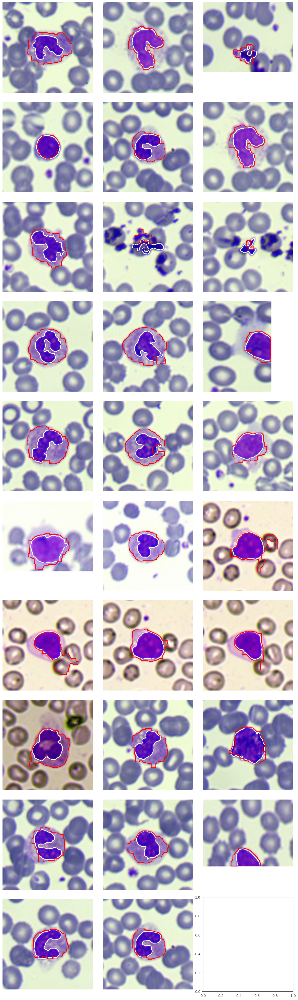

In [8]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

input_path = "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\cropped_images8"

processed_image = []
Cyto_area = []
Cyto_Perimeter = []
# Iterate over the images in the folder
for filename in os.listdir(input_path):
    if filename.endswith(".jpg"):
        image_path = os.path.join(input_path, filename)

       # Read the image
        image = cv2.imread(image_path)
        image_copy = image.copy()

        # plt.imshow(blurM)

        lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        img_hsv = cv2.cvtColor(lab, cv2.COLOR_BGR2HSV)

        # Define the lower and upper bounds for the green color in the HSV color space
        lower_green = np.array([40, 130, 170])
        upper_green = np.array([90, 255, 255])

        # Threshold the HSV image based on the color range
        img_mask = cv2.inRange(img_hsv, lower_green, upper_green)
        # plt.imshow(img_mask)
        # Find contours in the thresholded image
        contours, _ = cv2.findContours(
            img_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        def select_center_contour(contours):
            if len(contours) == 0:
                return None

            # Compute the areas of all contours
            contour_areas = [cv2.contourArea(contour) for contour in contours]

            # Find the index of the contour with the largest area
            max_area_index = np.argmax(contour_areas)

            # Return the contour with the largest area
            center_contour = contours[max_area_index]

            return center_contour
        nucleus_contour = select_center_contour(contours)
        cv2.drawContours(image_copy, [nucleus_contour], -1, (255, 255, 255), 2)

        # Draw the contours on the original image
        # cv2.drawContours(image_copy, contours, -1, (0, 255, 0), 2)
        # plt.subplot(144);plt.imshow(image_copy)
        # Display the final image in the corresponding grid cell
        pixels = image.reshape(-1, 3)
        pixels = np.float32(pixels)
        # Define the criteria for K-means clustering (maximum iterations and epsilon)
        criteria = (cv2.TERM_CRITERIA_EPS +
                    cv2.TERM_CRITERIA_MAX_ITER, 100, 0.5)

        # Perform K-means clustering
        k = 7  # Number of clusters
        _, labels, centers = cv2.kmeans(
            pixels, k, None, criteria, 100, cv2.KMEANS_RANDOM_CENTERS)

        # Convert the centers to unsigned integers
        centers = np.uint8(centers)
        # Map the labels to the centers
        segmented_image = centers[labels.flatten()]

        # Reshape the segmented image back to the original shape
        segmented_image = segmented_image.reshape(image.shape)

        # Convert the segmented image to grayscale
        segmented_image_gray = cv2.cvtColor(
            segmented_image, cv2.COLOR_RGB2GRAY)

        # Threshold the grayscale image
        _, segmented_mask = cv2.threshold(
            segmented_image_gray, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)

        # Apply the segmented mask to the original image
        segmented_result = cv2.bitwise_and(
            image_copy, image_copy, mask=segmented_mask)

        def smooth_contour(contour, epsilon):
            # Convert the contour to a numpy array
            contour = np.squeeze(contour)

            # Reshape the contour to fit the required format for cv2.approxPolyDP
            contour = contour.reshape((-1, 1, 2))

            # Apply the Douglas-Peucker algorithm for contour approximation
            smoothed_contour = cv2.approxPolyDP(contour, epsilon, True)

            return smoothed_contour
        mask = np.zeros(segmented_mask.shape[:2], dtype="uint8")
        segmented_copy = segmented_result.copy()
        # contours, _ = cv2.findContours(contour_portion,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        segmented_gray = cv2.cvtColor(segmented_result, cv2.COLOR_BGR2HSV)
        L, A, B = cv2.split(segmented_gray)
        kernel = np.ones((20, 10), np.uint8)
        _, thresholded_image = cv2.threshold(L, 128, 255, cv2.THRESH_BINARY)
        # Perform morphological closing to fill holes
        filled_image = cv2.morphologyEx(
            thresholded_image, cv2.MORPH_CLOSE, kernel)
        kernel = np.ones((15, 15), np.uint8)
        # Perform morphological opening to remove small dust particles
        opened_image = cv2.morphologyEx(filled_image, cv2.MORPH_OPEN, kernel)
        contours_cyto, _ = cv2.findContours(
            opened_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        # Select the center contour

        contour_areas = [cv2.contourArea(contour) for contour in contours_cyto]
        contour_perimeter = [cv2.arcLength(
            contour, True) for contour in contours_cyto]
        # Find the index of the contour with the largest area
        max_area_index = np.argmax(contour_areas)
        max_peri_index = np.argmax(contour_perimeter)
        area = contour_areas[max_area_index]
        peri = contour_perimeter[max_peri_index]
        Cyto_area.append(area)
        Cyto_Perimeter.append(peri)
        processed_image.append(image_copy)
        cv2.drawContours(
            image_copy, [contours_cyto[max_area_index]], -1, (0, 0, 255), 2)

# Create a grid for displaying the images
grid_rows = int(np.ceil(len(processed_image) / 3))
fig, axes = plt.subplots(grid_rows, 3, figsize=(12, 4 * grid_rows))

# Iterate over the processed images and display them in the grid
for i, image_x in enumerate(processed_image):
    row = i // 3
    col = i % 3
    axes[row, col].imshow(cv2.cvtColor(image_x, cv2.COLOR_BGR2RGB))
    axes[row, col].axis('off')

# Adjust the layout and display the grid
plt.tight_layout()
plt.show()

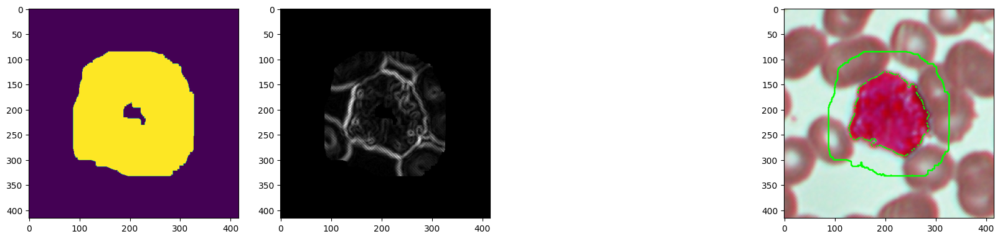

In [10]:
input_path = "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\cropped_images8\\final_image4.jpg"


def select_center_contour(contours):
    if len(contours) == 0:
        return None

    # Compute the areas of all contours
    contour_areas = [cv2.contourArea(contour) for contour in contours]

    # Find the index of the contour with the largest area
    max_area_index = np.argmax(contour_areas)

    # Return the contour with the largest area
    center_contour = contours[max_area_index]

    return center_contour


image = cv2.imread(input_path)

# Perform the processing steps
# image = cv2.imread(input_path)
image_copy = image.copy()

# plt.imshow(blurM)
plt.figure(figsize=(20, 20))
lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
img_hsv = cv2.cvtColor(lab, cv2.COLOR_BGR2HSV)

# Define the lower and upper bounds for the green color in the HSV color space
lower_green = np.array([40, 130, 170])
upper_green = np.array([90, 255, 255])

# Threshold the HSV image based on the color range
img_mask = cv2.inRange(img_hsv, lower_green, upper_green)
# plt.imshow(img_mask)
# Find contours in the thresholded image
nucleus_contours, _ = cv2.findContours(
    img_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
nucleus_contours = select_center_contour(nucleus_contours)
cv2.drawContours(image_copy, nucleus_contours, -1, (0, 255, 0), 2)
# Create a binary mask image and draw nuclei contours
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.drawContours(mask, nucleus_contours, -1, 255, thickness=cv2.FILLED)
# Dilate the nuclei contours
dilated_mask = cv2.dilate(mask, None, iterations=40)
plt.subplot(141)
plt.imshow(dilated_mask)
# Convert the image to grayscale
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
# Calculate the gradient using the Sobel operator
gradient_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
gradient_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)
gradient_magnitude = cv2.magnitude(gradient_x, gradient_y)
# Apply the mask to restrict the gradient to the cytoplasmic area
gradient_masked = cv2.bitwise_and(
    gradient_magnitude, gradient_magnitude, mask=dilated_mask)
# Convert the gradient image to the appropriate data type for thresholding
gradient_masked = cv2.convertScaleAbs(gradient_masked)
plt.subplot(142)
plt.imshow(gradient_masked, cmap="gray")


# Threshold the gradient image
_, thresholded = cv2.threshold(
    gradient_masked, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)


# Find contours of the cytoplasm boundary
contours, _ = cv2.findContours(
    gradient_masked.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Draw the contours on the original image
cv2.drawContours(image_copy, contours, -1, (0, 255, 0), 2)
plt.subplot(144)
plt.imshow(image_copy)

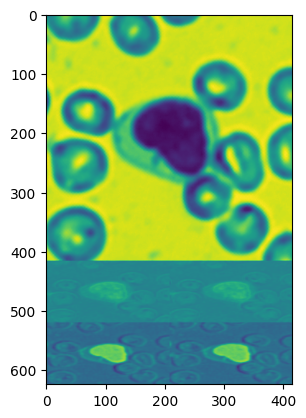

In [11]:
input_path = "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\cropped_images8\\final_image28.jpg"
image = cv2.imread(input_path)
image = cv2.cvtColor(image, cv2.COLOR_BGRA2YUV_YV12)
plt.imshow(image)

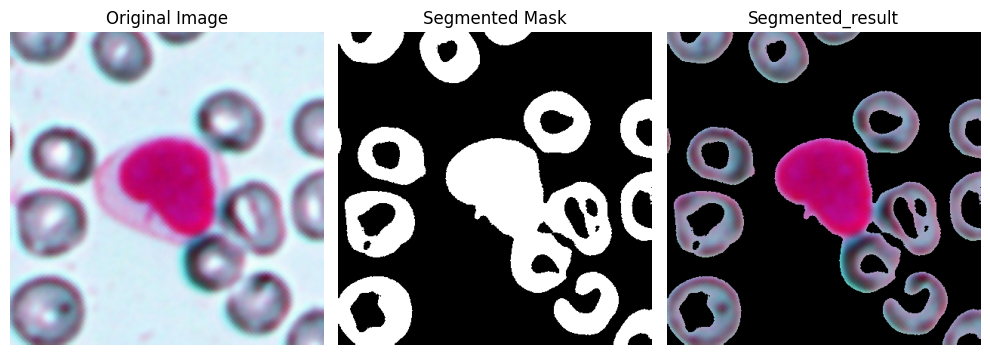

In [12]:
input_path = "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\cropped_images8\\final_image26.jpg"
image = cv2.imread(input_path)
# image = cv2.cvtColor(image,cv2.COLOR_BGR2LAB)
image_copy = image.copy()
pixels = image.reshape(-1, 3)
pixels = np.float32(pixels)
# Define the criteria for K-means clustering (maximum iterations and epsilon)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.9)

# Perform K-means clustering
k = 5  # Number of clusters
_, labels, centers = cv2.kmeans(
    pixels, k, None, criteria, 100, cv2.KMEANS_RANDOM_CENTERS)

# Convert the centers to unsigned integers
centers = np.uint8(centers)
# Map the labels to the centers
segmented_image = centers[labels.flatten()]

# Reshape the segmented image back to the original shape
segmented_image = segmented_image.reshape(image.shape)

# Convert the segmented image to grayscale
segmented_image_gray = cv2.cvtColor(segmented_image, cv2.COLOR_RGB2GRAY)

# Threshold the grayscale image
_, segmented_mask = cv2.threshold(
    segmented_image_gray, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)
# Creating kernel
# kernel = np.ones((13, 13), np.uint8)
# Using cv2.erode() method
# segmented_mask = cv2.erode(segmented_mask, kernel)
# Apply the segmented mask to the original image
segmented_result = cv2.bitwise_and(image_copy, image_copy, mask=segmented_mask)


# Perform morphological operations to clean up the mask (e.g., opening, closing)
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
# segmented_mask = cv2.morphologyEx(segmented_mask, cv2.MORPH_OPEN, kernel, iterations=4)
# segmented_mask = cv2.morphologyEx(segmented_mask, cv2.MORPH_CLOSE, kernel, iterations=2)

# Apply the segmented mask to the original image
# segmented_result = cv2.bitwise_and(image_copy,image_copy, mask=segmented_mask)


# Display the results
plt.figure(figsize=(10, 10))
plt.subplot(131)
plt.imshow(image)
plt.title('Original Image')
plt.axis('off')

plt.subplot(132)
plt.imshow(segmented_mask, cmap='gray')
plt.title('Segmented Mask')
plt.axis('off')

plt.subplot(133)
plt.imshow(segmented_result)
plt.title('Segmented_result')
plt.axis('off')

plt.tight_layout()
plt.show()
# In this example, the K-means clustering algorithm is used to group similar colors in the image into clusters. The resulting segmented mask is obtained by thresholding the grayscale image, followed by morphological operations for cleaning up the mask. Finally, the segmented mask is applied to the original image to obtain the segmented result.

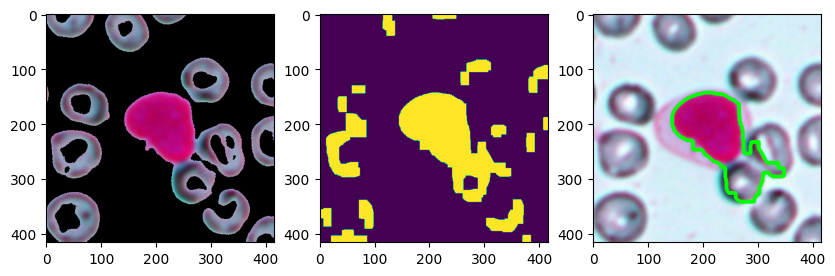

In [13]:
import cv2
import numpy as np
plt.figure(figsize=(10,10))
# Load the segmented mask image and the contour information
#segmented_mask = cv2.imread('segmented_mask.png', 0)
#contour = np.load('contour.npy')
plt.subplot(131);plt.imshow(segmented_result)
# Create a blank mask image of the same size as the segmented mask image
mask = np.zeros(segmented_mask.shape[:2], dtype="uint8")
#print(mask.shape)
# Creating kernel
#kernel = np.ones((3, 3), np.uint8)
 
#gradient_masked=cv2.erode(segmented_mask,kernel,iterations=4)
#gradient_masked = cv2.dilate(gradient_masked,kernel)
# Draw the contour on the blank mask image
#contours_1, _ = cv2.findContours(gradient_masked, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
#print(contours)
#cv2.drawContours(mask, contours_1,-1, 255, thickness=cv2.FILLED)
#cv2.rectangle(contour_mask, (0, 90), (200, 286), 255, -1)
# Apply bitwise AND operation between the segmented mask and the contour mask
contour_portion = cv2.bitwise_and(segmented_mask,segmented_mask, mask= mask)
segmented_copy = segmented_result.copy()
#contours, _ = cv2.findContours(contour_portion,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
def select_center_contour(contours):
            if len(contours) == 0:
                return None

            # Compute the areas of all contours
            contour_areas = [cv2.contourArea(contour) for contour in contours]

            # Find the index of the contour with the largest area
            max_area_index = np.argmax(contour_areas)

            # Return the contour with the largest area
            center_contour = contours[max_area_index]
        
            
            return center_contour
segmented_gray = cv2.cvtColor(segmented_result, cv2.COLOR_BGR2HSV)
L,A,B= cv2.split(segmented_gray)
#equalized_image = cv2.equalizeHist(segmented_gray)
# Create CLAHE object
clahe = cv2.createCLAHE(clipLimit=0.5, tileGridSize=(8, 8))

# Apply CLAHE to the equalized image
#clahe_image = clahe.apply(equalized_image)
# Apply thresholding to the CLAHE transformed image
kernel = np.ones((20, 10), np.uint8)
_, thresholded_image = cv2.threshold(L, 128, 255, cv2.THRESH_BINARY)
# Perform morphological closing to fill holes
filled_image = cv2.morphologyEx(thresholded_image, cv2.MORPH_CLOSE, kernel)
kernel = np.ones((15, 15), np.uint8)
# Perform morphological opening to remove small dust particles
opened_image = cv2.morphologyEx(filled_image, cv2.MORPH_OPEN, kernel)
contours, _ = cv2.findContours(opened_image,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
contours = select_center_contour(contours)
cv2.drawContours(image_copy, [contours], -1, (0,255, 0),5)
# Define the kernel for erosion and dilation
#

# Perform erosion
#eroded_image = cv2.erode(thresholded_image, kernel, iterations=2)

plt.subplot(132);plt.imshow(opened_image)
#contours = select_center_contour(contours)
cv2.drawContours(image_copy, [contours], -1, (0,255, 0),5)
plt.subplot(133);plt.imshow(image_copy)

(416, 416, 4)


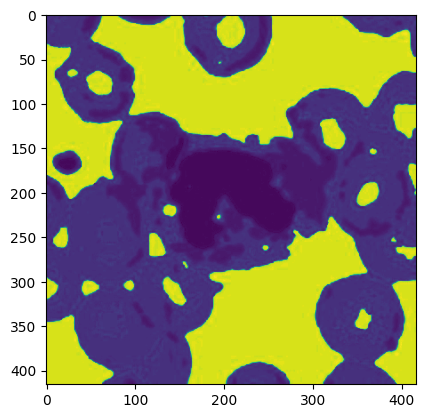

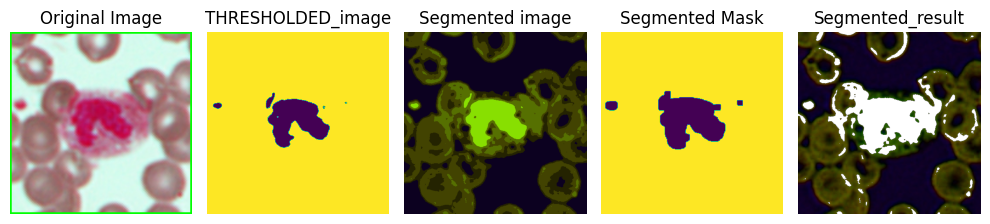

In [45]:
image = cv2.imread(
    "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\blue_images_sample\\final_image1.jpg")
image_copy = image.copy()
# Define the RGB to CMYK conversion function


def bgr_to_cmyk(bgr):
    b, g, r = bgr/255.0
    b, g, r = b/255.0, g/255.0, r/255.0
    k = 1 - np.max([b, g, r])
    if k == 1:
        c = m = y = 0
    else:
        c = (1 - r - k) / (1 - k)
        m = (1 - g - k) / (1 - k)
        y = (1 - b - k) / (1 - k)
    return np.array([c, m, y, k])


def cmyk_to_bgr(cmyk):
    c, m, y, k = cv2.split(cmyk)
    r = 255 * (1 - (c * (1 - k) + k))
    g = 255 * (1 - (m * (1 - k) + k))
    b = 255 * (1 - (y * (1 - k) + k))
    return np.array([b, g, r], dtype=np.uint8)


# Apply the RGB to CMYK conversion to each pixel using a lambda function
cmyk_img = np.apply_along_axis(lambda x: bgr_to_cmyk(x), axis=2, arr=image)
cmyk_img_copy = cmyk_img.copy()
# plt.imshow(cmyk_img)
# Scale the values in the CMYK image to the range 0-255
cmyk_img = (cmyk_img*255).astype(np.uint8)

pixels = cmyk_img.reshape(-1, 4)
pixels = np.float32(pixels)
# Define the criteria for K-means clustering (maximum iterations and epsilon)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.9)

# Perform K-means clustering
k = 5  # Number of clusters
_, labels, centers = cv2.kmeans(
    pixels, k, None, criteria, 100, cv2.KMEANS_RANDOM_CENTERS)

# Convert the centers to unsigned integers
centers = np.uint8(centers)
# Map the labels to the centers
segmented_image = centers[labels.flatten()]

# Reshape the segmented image back to the original shape
segmented_image = segmented_image.reshape(cmyk_img.shape)
# plt.imshow(segmented_image)
print(segmented_image.shape)
cv2.imwrite("segmented_image.jpg", segmented_image)
# Apply the RGB to CMYK conversion to each pixel using a lambda function
bgr_img = cv2.imread("segmented_image.jpg")

# bgr_image = cv2.cvtColor(segmented_image, cv2.COLOR_CMYK2BGR)
# Scale the values in the CMYK image to the range 0-255
# bgr_image = (bgr_img*255).astype(np.uint8)
plt.imshow(bgr_img)
# Convert the segmented image to grayscale
segmented_HSV = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2HSV)
plt.imshow(segmented_HSV)
segmented_image_gray = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2GRAY)
# Set the threshold value (adjust as needed)
threshold = 150
# Apply thresholding
# ret, binary_image = cv2.threshold(segmented_image_gray, threshold, 20, cv2.THRESH_BINARY)
# Threshold the grayscale image
_, segmented_mask = cv2.threshold(
    segmented_image_gray, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)
# Creating kernel
# kernel = np.ones((13, 13), np.uint8)
# Using cv2.erode() method
# segmented_mask = cv2.erode(segmented_mask, kernel)
# Apply the segmented mask to the original image
segmented_result = cv2.bitwise_and(
    cmyk_img_copy, cmyk_img_copy, mask=segmented_mask)


def select_center_contour(contours):
    if len(contours) == 0:
        return None

    # Compute the areas of all contours
    contour_areas = [cv2.contourArea(contour) for contour in contours]

    # Find the index of the contour with the largest area
    max_area_index = np.argmax(contour_areas)

    # Return the contour with the largest area
    center_contour = contours[max_area_index]

    return center_contour


mask = np.zeros(segmented_mask.shape[:2], dtype="uint8")
# print(mask.shape)
# Creating kernel
# kernel = np.ones((3, 3), np.uint8)

# gradient_masked=cv2.erode(segmented_mask,kernel,iterations=4)
# gradient_masked = cv2.dilate(gradient_masked,kernel)
# Draw the contour on the blank mask image
# contours_1, _ = cv2.findContours(gradient_masked, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
# print(contours)
# cv2.drawContours(mask, contours_1,-1, 255, thickness=cv2.FILLED)
# cv2.rectangle(contour_mask, (0, 90), (200, 286), 255, -1)
# Apply bitwise AND operation between the segmented mask and the contour mask
contour_portion = cv2.bitwise_and(segmented_mask, segmented_mask, mask=mask)
segmented_copy = segmented_result.copy()
# contours, _ = cv2.findContours(contour_portion,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)


def select_center_contour(contours):
    if len(contours) == 0:
        return None

    # Compute the areas of all contours
    contour_areas = [cv2.contourArea(contour) for contour in contours]

    # Find the index of the contour with the largest area
    max_area_index = np.argmax(contour_areas)

    # Return the contour with the largest area
    center_contour = contours[max_area_index]

    return center_contour


def smooth_contour(contour, epsilon):
    # Convert the contour to a numpy array
    contour = np.squeeze(contour)

    # Reshape the contour to fit the required format for cv2.approxPolyDP
    contour = contour.reshape((-1, 1, 2))

    # Apply the Douglas-Peucker algorithm for contour approximation
    smoothed_contour = cv2.approxPolyDP(contour, epsilon, True)

    return smoothed_contour


L, A, B = cv2.split(segmented_HSV)
plt.imshow(L)
# Apply thresholding to the CLAHE transformed image
kernel = np.ones((3, 3), np.uint8)
_, thresholded_image = cv2.threshold(L, 80, 255, cv2.THRESH_BINARY)
'''# Perform morphological closing to fill holes
filled_image = cv2.morphologyEx(thresholded_image, cv2.MORPH_CLOSE, kernel)
kernel = np.ones((3, 3), np.uint8)
# Perform morphological opening to remove small dust particles
opened_image = cv2.morphologyEx(filled_image, cv2.MORPH_OPEN, kernel)
contours, _ = cv2.findContours(opened_image,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)'''
# contours = select_center_contour(contours)
# Define the kernel for erosion and dilation
kernel = np.ones((5, 5), np.uint8)
# cv2.drawContours(image_copy, contours, -1, (0, 255, 0), 2)
segmented_mask = cv2.erode(thresholded_image, kernel, iterations=2)
segmented_mask = cv2.morphologyEx(
    segmented_mask, cv2.MORPH_OPEN, kernel, iterations=1)
'''# Perform morphological operations to clean up the mask (e.g., opening, closing)
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (10, 10))
segmented_mask = cv2.morphologyEx(thresholded_image, cv2.MORPH_OPEN, kernel, iterations=4)
segmented_mask = cv2.morphologyEx(thresholded_image, cv2.MORPH_CLOSE, kernel, iterations=2)'''

contours, _ = cv2.findContours(
    segmented_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
contours = select_center_contour(contours)
contour_areas = [cv2.contourArea(contour) for contour in contours]

# Find the index of the contour with the largest area
max_area_index = np.argmax(contour_areas)
# Choose the index of the contour you want to smoothen

# Set the epsilon value for contour smoothing (adjust as needed)
epsilon = 0.004 * cv2.arcLength(contours_cyto[max_area_index], True)
contours = smooth_contour(contours, epsilon)
cv2.drawContours(image_copy, [contours], -1, (0, 255, 0), 5)
# Define the kernel for erosion and dilation
# Apply the segmented mask to the original image
# segmented_result = cv2.bitwise_and(image_copy,image_copy, mask=segmented_mask)


# Display the results
plt.figure(figsize=(10, 10))
plt.subplot(151)
plt.imshow(image_copy)
plt.title('Original Image')
plt.axis('off')

plt.subplot(152)
plt.imshow(thresholded_image)
plt.title('THRESHOLDED_image')
plt.axis('off')

plt.subplot(153)
plt.imshow(segmented_image)
plt.title('Segmented image')
plt.axis('off')

plt.subplot(154)
plt.imshow(segmented_mask)
plt.title('Segmented Mask')
plt.axis('off')

plt.subplot(155)
plt.imshow(segmented_result)
plt.title('Segmented_result')
plt.axis('off')

plt.tight_layout()
plt.show()
# In this example, the K-means clustering algorithm is used to group similar colors in the image into clusters. The resulting segmented mask is obtained by thresholding the grayscale image, followed by morphological operations for cleaning up the mask. Finally, the segmented mask is applied to the original image to obtain the segmented result.

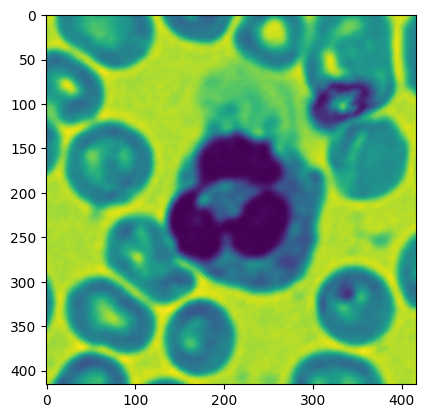

In [15]:
b, g, r = cv2.split(image)
plt.imshow(g)

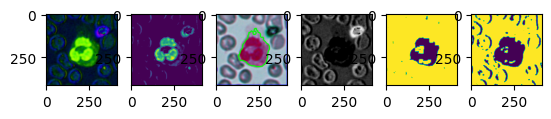

In [16]:

c, m, y, k = cv2.split(cmyk_img)
cv2.imwrite("y_image.jpg", y)
y_gray = cv2.imread("y_image.jpg", cv2.IMREAD_GRAYSCALE)
# Set the threshold value (adjust as needed)
threshold = 10
# Apply thresholding
ret, binary_image = cv2.threshold(y_gray, threshold, 20, cv2.THRESH_BINARY)
kernel = np.ones((3, 3), np.uint8)
binary_image = cv2.erode(binary_image, kernel, iterations=3)
binary_image = cv2.dilate(binary_image, kernel, iterations=3)
# Perform morphological operations to remove dust
kernel = np.ones((3, 3), np.uint8)
dust_removed = cv2.morphologyEx(binary_image, cv2.MORPH_OPEN, kernel)
binary_image = cv2.dilate(dust_removed, kernel, iterations=5)
# Find contours of the darker region
contours, _ = cv2.findContours(
    binary_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
# Draw contours on the image copy
cv2.drawContours(image_copy, contours, -1, (0, 0, 255), 2)

plt.subplot(161)
plt.imshow(cmyk_img)
plt.subplot(162)
plt.imshow(c)
plt.subplot(163)
plt.imshow(image_copy)
plt.subplot(164)
plt.imshow(y, cmap='gray')
plt.subplot(165)
plt.imshow(binary_image)
plt.subplot(166)
plt.imshow(dust_removed)

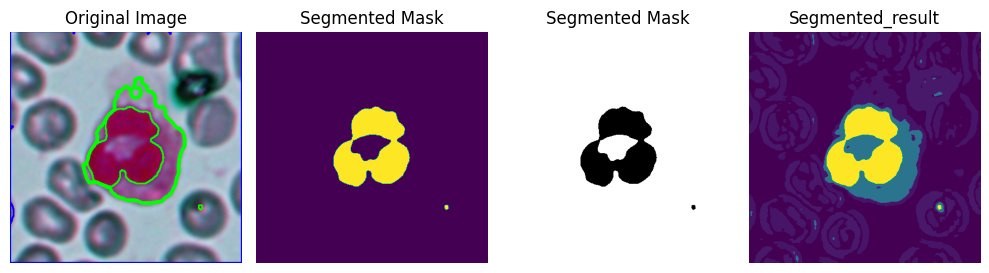

In [18]:
pixels = cmyk_img.reshape(-1, 4)
pixels = np.float32(pixels)
# Define the criteria for K-means clustering (maximum iterations and epsilon)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.9)

# Perform K-means clustering
k = 5  # Number of clusters
_, labels, centers = cv2.kmeans(
    pixels, k, None, criteria, 100, cv2.KMEANS_RANDOM_CENTERS)

# Convert the centers to unsigned integers
centers = np.uint8(centers)
# Map the labels to the centers
segmented_image = centers[labels.flatten()]

# Reshape the segmented image back to the original shape
segmented_image = segmented_image.reshape(cmyk_img.shape)

# Convert the segmented image to grayscale
segmented_image_gray = cv2.cvtColor(segmented_image, cv2.COLOR_RGB2GRAY)
# Set the threshold value (adjust as needed)
threshold = 150
# Apply thresholding
ret, binary_image = cv2.threshold(
    segmented_image_gray, threshold, 20, cv2.THRESH_BINARY)
# Threshold the grayscale image
_, segmented_mask = cv2.threshold(
    segmented_image_gray, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)
# Creating kernel
# kernel = np.ones((13, 13), np.uint8)
# Using cv2.erode() method
# segmented_mask = cv2.erode(segmented_mask, kernel)
# Apply the segmented mask to the original image
segmented_result = cv2.bitwise_and(image_copy, image_copy, mask=segmented_mask)

# Find contours of the darker region
contours, _ = cv2.findContours(
    segmented_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
# Draw contours on the image copy
cv2.drawContours(image_copy, contours, -1, (0, 0, 255), 2)
# Find contours of the darker region
contours, _ = cv2.findContours(
    binary_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
# Draw contours on the image copy
cv2.drawContours(image_copy, contours, -1, (0, 255, 0), 2)
# Perform morphological operations to clean up the mask (e.g., opening, closing)
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
# segmented_mask = cv2.morphologyEx(segmented_mask, cv2.MORPH_OPEN, kernel, iterations=4)
# segmented_mask = cv2.morphologyEx(segmented_mask, cv2.MORPH_CLOSE, kernel, iterations=2)

# Apply the segmented mask to the original image
# segmented_result = cv2.bitwise_and(image_copy,image_copy, mask=segmented_mask)


# Display the results
plt.figure(figsize=(10, 10))
plt.subplot(141)
plt.imshow(image_copy)
plt.title('Original Image')
plt.axis('off')

plt.subplot(142)
plt.imshow(binary_image)
plt.title('Segmented Mask')
plt.axis('off')

plt.subplot(143)
plt.imshow(segmented_mask, cmap='gray')
plt.title('Segmented Mask')
plt.axis('off')

plt.subplot(144)
plt.imshow(segmented_image_gray)
plt.title('Segmented_result')
plt.axis('off')

plt.tight_layout()
plt.show()
# In this example, the K-means clustering algorithm is used to group similar colors in the image into clusters. The resulting segmented mask is obtained by thresholding the grayscale image, followed by morphological operations for cleaning up the mask. Finally, the segmented mask is applied to the original image to obtain the segmented result.

In [19]:
# Apply the RGB to CMYK conversion to each pixel using a lambda function
cmyk_img = np.apply_along_axis(lambda x: bgr_to_cmyk(x), axis=2, arr=image)

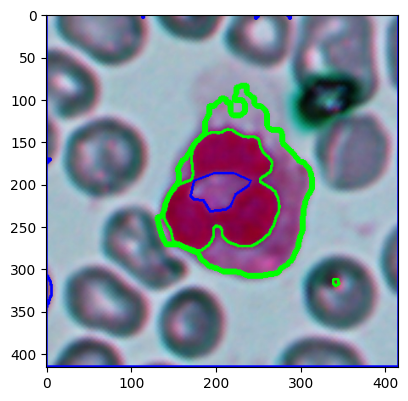

In [20]:
import cv2
import numpy as np
plt.figure(figsize=(10, 10))
# Load the segmented mask image and the contour information
# segmented_mask = cv2.imread('segmented_mask.png', 0)
# contour = np.load('contour.npy')
plt.subplot(121)
plt.imshow(segmented_result)
# Create a blank mask image of the same size as the segmented mask image
mask = np.zeros(segmented_mask.shape[:2], dtype="uint8")
# print(mask.shape)
# Draw the contour on the blank mask image
# contours_1, _ = cv2.findContours(gradient_masked.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
# print(contours)
cv2.drawContours(mask, contours, -1, 255, thickness=cv2.FILLED)
# cv2.rectangle(contour_mask, (0, 90), (200, 286), 255, -1)
# Apply bitwise AND operation between the segmented mask and the contour mask
contour_portion = cv2.bitwise_and(segmented_mask, segmented_mask, mask=mask)
segmented_copy = segmented_result.copy()
contours, _ = cv2.findContours(
    contour_portion, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)


def smooth_contour(contour, epsilon):
    # Convert the contour to a numpy array
    contour = np.squeeze(contour)

    # Reshape the contour to fit the required format for cv2.approxPolyDP
    contour = contour.reshape((-1, 1, 2))

    # Apply the Douglas-Peucker algorithm for contour approximation
    smoothed_contour = cv2.approxPolyDP(contour, epsilon, True)

    return smoothed_contour


contour_areas = [cv2.contourArea(contour) for contour in contours]

# Find the index of the contour with the largest area
max_area_index = np.argmax(contour_areas)
# Choose the index of the contour you want to smoothen

# Set the epsilon value for contour smoothing (adjust as needed)
epsilon = 0.01 * cv2.arcLength(contours[max_area_index], True)
# Smoothen the contour
smoothed_contours = [smooth_contour(contour, epsilon) for contour in contours]
# Draw the original and smoothed contours on the image
# cv2.drawContours(image, [contours[contour_index]], -1, (0, 255, 0), 2)
cv2.drawContours(image_copy, smoothed_contours, -1, (0, 0, 255), 2)
plt.imshow(image_copy)

In [21]:
# Final Function for nucleus parameters and cytoplasm
# Directory containing the images
input_dir = "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\cropped_images8"
imagename = []
# List to store the processed images
processed_images = []
Nucleus_Areas = []
Nucleus_Perimeters = []
Area_hull = []
Perimeter_hull = []
Cyto_Area = []
Cyto_Perimeter = []
# Iterate over the images in the directory
for filename in os.listdir(input_dir):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        # Read the image
        input_path = os.path.join(input_dir, filename)
        image = cv2.imread(input_path)

        # Perform the processing steps
        # image = cv2.imread(input_path)
        image_copy = image.copy()

        # plt.imshow(blurM)

        lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        img_hsv = cv2.cvtColor(lab, cv2.COLOR_BGR2HSV)

        # Define the lower and upper bounds for the green color in the HSV color space
        lower_green = np.array([40, 130, 170])
        upper_green = np.array([90, 255, 255])

       # Threshold the HSV image based on the color range
        img_mask = cv2.inRange(img_hsv, lower_green, upper_green)
        # plt.imshow(img_mask)
        # Find contours in the thresholded image
        contours, _ = cv2.findContours(
            img_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        pixels = image.reshape(-1, 3)
        pixels = np.float32(pixels)
        # Define the criteria for K-means clustering (maximum iterations and epsilon)
        criteria = (cv2.TERM_CRITERIA_EPS +
                    cv2.TERM_CRITERIA_MAX_ITER, 100, 0.5)

        # Perform K-means clustering
        k = 7  # Number of clusters
        _, labels, centers = cv2.kmeans(
            pixels, k, None, criteria, 100, cv2.KMEANS_RANDOM_CENTERS)

        # Convert the centers to unsigned integers
        centers = np.uint8(centers)
        # Map the labels to the centers
        segmented_image = centers[labels.flatten()]

        # Reshape the segmented image back to the original shape
        segmented_image = segmented_image.reshape(image.shape)

        # Convert the segmented image to grayscale
        segmented_image_gray = cv2.cvtColor(
            segmented_image, cv2.COLOR_RGB2GRAY)

        # Threshold the grayscale image
        _, segmented_mask = cv2.threshold(
            segmented_image_gray, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)

        # Apply the segmented mask to the original image
        segmented_result = cv2.bitwise_and(
            image_copy, image_copy, mask=segmented_mask)

        mask = np.zeros(segmented_mask.shape[:2], dtype="uint8")
        segmented_copy = segmented_result.copy()
        # contours, _ = cv2.findContours(contour_portion,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        segmented_gray = cv2.cvtColor(segmented_result, cv2.COLOR_BGR2HSV)
        L, A, B = cv2.split(segmented_gray)
        kernel = np.ones((15, 15), np.uint8)
        _, thresholded_image = cv2.threshold(L, 128, 255, cv2.THRESH_BINARY)
        # Perform morphological closing to fill holes
        filled_image = cv2.morphologyEx(
            thresholded_image, cv2.MORPH_CLOSE, kernel)
        kernel = np.ones((20, 10), np.uint8)
        # Perform morphological opening to remove small dust particles
        opened_image = cv2.morphologyEx(filled_image, cv2.MORPH_OPEN, kernel)
        contours_cyto, _ = cv2.findContours(
            opened_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        # Select the center contour

        def smooth_contour(contour, epsilon):
            # Convert the contour to a numpy array
            contour = np.squeeze(contour)

            # Reshape the contour to fit the required format for cv2.approxPolyDP
            contour = contour.reshape((-1, 1, 2))

            # Apply the Douglas-Peucker algorithm for contour approximation
            smoothed_contour = cv2.approxPolyDP(contour, epsilon, True)

            return smoothed_contour

        def select_center_contour(contours):
            if len(contours) == 0:
                return None

            # Compute the areas of all contours
            contour_areas = [cv2.contourArea(contour) for contour in contours]

            # Find the index of the contour with the largest area
            max_area_index = np.argmax(contour_areas)

            # Return the contour with the largest area
            center_contour = contours[max_area_index]

            return center_contour

        contour_areas = [cv2.contourArea(contour) for contour in contours]

        # Find the index of the contour with the largest area
        max_area_index = np.argmax(contour_areas)
        # Choose the index of the contour you want to smoothen

        # Set the epsilon value for contour smoothing (adjust as needed)
        # epsilon = 0.03 * cv2.arcLength(contours[max_area_index], True)
        # Smoothen the contour
        # smoothed_contours = [smooth_contour(contour, epsilon) for contour in contours]

        # contour_areas = [cv2.contourArea(contour) for contour in contours_cyto]
        # contour_perimeter = [cv2.arcLength(contour, True) for contour in contours_cyto]
        # Find the index of the contour with the largest area
        # max_area_index = np.argmax(contour_areas)
        # max_peri_index = np.argmax(contour_perimeter)
        # area = contour_areas[max_area_index]
        # peri = contour_perimeter[max_peri_index]

        # processed_image.append(image_copy)
        # cv2.drawContours(image_copy, contours_cyto, -1, (0,0,255),2)
        # Select the center contour
    contour_areas = [cv2.contourArea(contour) for contour in contours_cyto]

    # Find the index of the contour with the largest area
    max_area_index = np.argmax(contour_areas)
    # Choose the index of the contour you want to smoothen

    # Set the epsilon value for contour smoothing (adjust as needed)
    epsilon = 0.004 * cv2.arcLength(contours_cyto[max_area_index], True)
    contours_cyto_center = select_center_contour(contours_cyto)
    smoothed_cyto = smooth_contour(contours_cyto_center, epsilon)
    center_contour = select_center_contour(contours)
    convex_hull = cv2.convexHull(center_contour)
    Area_hull.append(cv2.contourArea(convex_hull))
    Perimeter_hull.append(cv2.arcLength(convex_hull, True))
    # convex_hull_cyto = cv2.convexHull(contours_cyto_center)
    Cyto_Area.append(cv2.contourArea(convex_hull_cyto))
    Cyto_Perimeter.append(cv2.arcLength(convex_hull_cyto, True))
    # Check if a center contour was found
    if center_contour is not None:
        # Draw the center contour on the image
        cv2.drawContours(image_copy, [center_contour], -1, (0, 255, 0), 2)
        cv2.drawContours(image_copy, [smoothed_cyto], -1, (0, 0, 255), 2)

    # ... additional processing or analysis using the center contour
    else:
        print("No center contour found.")

    '''Areas.append(area)
    Perimeters.append(perimeter)'''
    processed_images.append(image_copy)

    # cv2.drawContours(image_copy, [contours_cyto_center], -1, (255,0,0),2)
# Create a grid for displaying the images
grid_rows = int(np.ceil(len(processed_images) / 3))
fig, axes = plt.subplots(grid_rows, 3, figsize=(10, 4*grid_rows))

# Iterate over the processed images and display them in the grid
for i, image in enumerate(processed_images):
    row = i // 3
    col = i % 3
    axes[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[row, col].axis('off')

# Adjust the layout and display the grid
plt.tight_layout()
plt.show()

NameError: name 'convex_hull_cyto' is not defined

In [22]:
import pandas as pd
final_df = pd.read_csv(
    "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\final.csv", index_col=0)
final_df["CONVEX_Cyto_Area"] = Cyto_Area
final_df["CONVEX_Cyto_Perimeter"] = Cyto_Perimeter
final_df["cytoplam_nucleus_area_ratio"] = final_df["CONVEX_Cyto_Area"] / \
    final_df["NUCLEUS_AREA"]
final_df = final_df.rename(columns={
                           "CYTO_AREA": "CONVEX_AREA_NUCLEUS", "CYTO_PERIMETER": "CONVEX_PERIMETER_NUCLEUS"})
final_df.loc[:, (0, 13)].sort_values('cytoplam_nucleus_area_ratio')

ValueError: Length of values (0) does not match length of index (29)

In [21]:
final_df.shape

(29, 14)

In [23]:
input_path = "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\cropped_images8\\final_image20.jpg"
image = cv2.imread(input_path)
# image = cv2.cvtColor(image,cv2.COLOR_BGR2LAB)
image_copy = image.copy()
pixels = image.reshape(-1, 3)
pixels = np.float32(pixels)
# Define the criteria for K-means clustering (maximum iterations and epsilon)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.5)

# Perform K-means clustering
k = 5  # Number of clusters
_, labels, centers = cv2.kmeans(
    pixels, k, None, criteria, 100, cv2.KMEANS_RANDOM_CENTERS)

# Convert the centers to unsigned integers
centers = np.uint8(centers)
# Map the labels to the centers
segmented_image = centers[labels.flatten()]

# Reshape the segmented image back to the original shape
segmented_image = segmented_image.reshape(image.shape)

# Convert the segmented image to grayscale
segmented_image_gray = cv2.cvtColor(segmented_image, cv2.COLOR_RGB2GRAY)

# Threshold the grayscale image
_, segmented_mask = cv2.threshold(
    segmented_image_gray, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)
# Creating kernel
# kernel = np.ones((13, 13), np.uint8)
# Using cv2.erode() method
# segmented_mask = cv2.erode(segmented_mask, kernel)
# Apply the segmented mask to the original image
segmented_result = cv2.bitwise_and(image_copy, image_copy, mask=segmented_mask)

In [24]:
output_folder = "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\segmented_images"
os.makedirs(output_folder, exist_ok=True)

In [25]:
import cv2
import numpy as np
import os
processed_image_new = []
# Input and output paths
input_folder = "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\cropped_images8"


# Define the criteria for K-means clustering
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.5)
k = 5  # Number of clusters

# Get the list of input files
input_files = os.listdir(input_folder)

# Iterate over the input files
for file_name in input_files:
    # Read the input image
    input_path = os.path.join(input_folder, file_name)
    image = cv2.imread(input_path)
    image_copy = image.copy()

    # Reshape the image for clustering
    pixels = image.reshape(-1, 3)
    pixels = np.float32(pixels)

    # Perform K-means clustering
    _, labels, centers = cv2.kmeans(
        pixels, k, None, criteria, 100, cv2.KMEANS_RANDOM_CENTERS)

    # Convert the centers to unsigned integers
    centers = np.uint8(centers)

    # Map the labels to the centers
    segmented_image = centers[labels.flatten()]

    # Reshape the segmented image back to the original shape
    segmented_image = segmented_image.reshape(image.shape)

    # Convert the segmented image to grayscale
    segmented_image_gray = cv2.cvtColor(segmented_image, cv2.COLOR_RGB2GRAY)

    # Threshold the grayscale image
    _, segmented_mask = cv2.threshold(
        segmented_image_gray, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)

    # Apply the segmented mask to the original image
    segmented_result = cv2.bitwise_and(
        image_copy, image_copy, mask=segmented_mask)
    processed_image_new.append(segmented_result)
    # Save the segmented image
    output_path = os.path.join(output_folder, file_name)
    cv2.imwrite(output_path, segmented_result)

In [30]:
# Input and output paths
input_folder = "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\cropped_images8"
output_folder = "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\segmented_images"

In [31]:
print(os.path.join(output_folder, "abhi.jpg"))

C:\Users\krrah\Downloads\Dewinter2023\Final_yolov5x\segmented_images\abhi.jpg


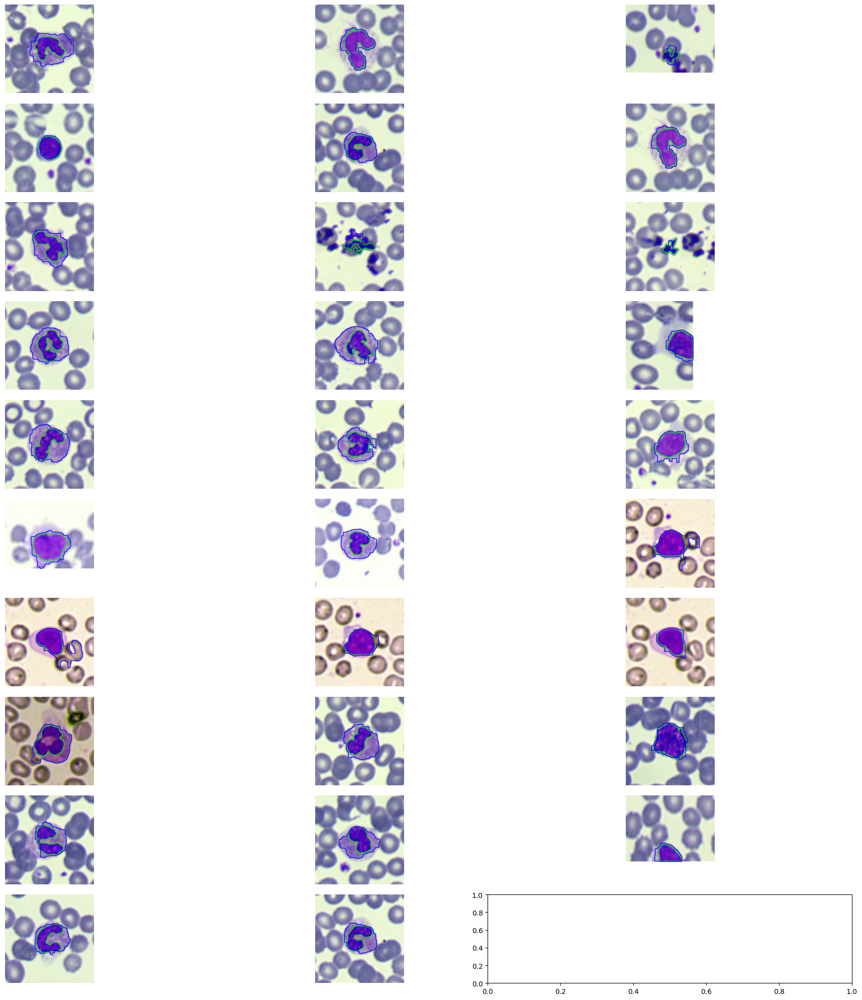

In [39]:
# Final Function for nucleus parameters and cytoplasm
# Directory containing the images
input_dir = "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\cropped_images8"
imagename = []
# List to store the processed images
processed_images = []
Nucleus_Areas = []
Nucleus_Perimeters = []
Area_hull = []
Perimeter_hull = []
Cyto_Area = []
Cyto_Perimeter = []
# Iterate over the images in the directory
for filename in os.listdir(input_dir):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        # Read the image
        input_path = os.path.join(input_dir, filename)
        image = cv2.imread(input_path)

        # Perform the processing steps
        # image = cv2.imread(input_path)
        image_copy = image.copy()

        # plt.imshow(blurM)

        lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        img_hsv = cv2.cvtColor(lab, cv2.COLOR_BGR2HSV)

        # Define the lower and upper bounds for the green color in the HSV color space
        lower_green = np.array([40, 130, 170])
        upper_green = np.array([90, 255, 255])

       # Threshold the HSV image based on the color range
        img_mask = cv2.inRange(img_hsv, lower_green, upper_green)
        # plt.imshow(img_mask)
        # Find contours in the thresholded image
        contours, _ = cv2.findContours(
            img_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        pixels = image.reshape(-1, 3)
        pixels = np.float32(pixels)
        # Define the criteria for K-means clustering (maximum iterations and epsilon)
        criteria = (cv2.TERM_CRITERIA_EPS +
                    cv2.TERM_CRITERIA_MAX_ITER, 100, 0.5)

        # Perform K-means clustering
        k = 7  # Number of clusters
        _, labels, centers = cv2.kmeans(
            pixels, k, None, criteria, 100, cv2.KMEANS_RANDOM_CENTERS)

        # Convert the centers to unsigned integers
        centers = np.uint8(centers)
        # Map the labels to the centers
        segmented_image = centers[labels.flatten()]

        # Reshape the segmented image back to the original shape
        segmented_image = segmented_image.reshape(image.shape)

        # Convert the segmented image to grayscale
        segmented_image_gray = cv2.cvtColor(
            segmented_image, cv2.COLOR_RGB2GRAY)

        # Threshold the grayscale image
        _, segmented_mask = cv2.threshold(
            segmented_image_gray, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)

        # Apply the segmented mask to the original image
        segmented_result = cv2.bitwise_and(
            image_copy, image_copy, mask=segmented_mask)

        mask = np.zeros(segmented_mask.shape[:2], dtype="uint8")
        segmented_copy = segmented_result.copy()
        # contours, _ = cv2.findContours(contour_portion,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        segmented_gray = cv2.cvtColor(segmented_result, cv2.COLOR_BGR2HSV)
        L, A, B = cv2.split(segmented_gray)
        kernel = np.ones((15, 15), np.uint8)
        _, thresholded_image = cv2.threshold(L, 128, 255, cv2.THRESH_BINARY)
        # Perform morphological closing to fill holes
        filled_image = cv2.morphologyEx(
            thresholded_image, cv2.MORPH_CLOSE, kernel)
        kernel = np.ones((20, 10), np.uint8)
        # Perform morphological opening to remove small dust particles
        opened_image = cv2.morphologyEx(filled_image, cv2.MORPH_OPEN, kernel)
        contours_cyto, _ = cv2.findContours(
            opened_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        # Select the center contour

        contour_areas = [cv2.contourArea(contour) for contour in contours_cyto]
        contour_perimeter = [cv2.arcLength(
            contour, True) for contour in contours_cyto]
        # Find the index of the contour with the largest area
        max_area_index = np.argmax(contour_areas)
        max_peri_index = np.argmax(contour_perimeter)
        area = contour_areas[max_area_index]
        peri = contour_perimeter[max_peri_index]
        Cyto_Area.append(area)
        Cyto_Perimeter.append(peri)
        # processed_image.append(image_copy)
        # cv2.drawContours(image_copy, contours_cyto, -1, (0,0,255),2)
        # Select the center contour
    contours_cyto_center = select_center_contour(contours_cyto)
    center_contour = select_center_contour(contours)
    convex_hull = cv2.convexHull(center_contour)
    Area_hull.append(cv2.contourArea(convex_hull))
    Perimeter_hull.append(cv2.arcLength(convex_hull, True))

    # Check if a center contour was found
    if center_contour is not None:
        # Draw the center contour on the image
        cv2.drawContours(image_copy, [center_contour], -1, (0, 255, 0), 2)
        # cv2.drawContours(image_copy, [convex_hull], -1, (0, 0, 255), 2)

    # ... additional processing or analysis using the center contour
    else:
        print("No center contour found.")

    '''Areas.append(area)
    Perimeters.append(perimeter)'''
    processed_images.append(image_copy)

    cv2.drawContours(image_copy, [contours_cyto_center], -1, (255, 0, 0), 2)
# Create a grid for displaying the images
grid_rows = int(np.ceil(len(processed_images) / 3))
fig, axes = plt.subplots(grid_rows, 3, figsize=(20, 20))

# Iterate over the processed images and display them in the grid
for i, image in enumerate(processed_images):
    row = i // 3
    col = i % 3
    axes[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[row, col].axis('off')

# Adjust the layout and display the grid
plt.tight_layout()
plt.show()

Code to detect the cytoplasm of Red sample images

(416, 416, 4)


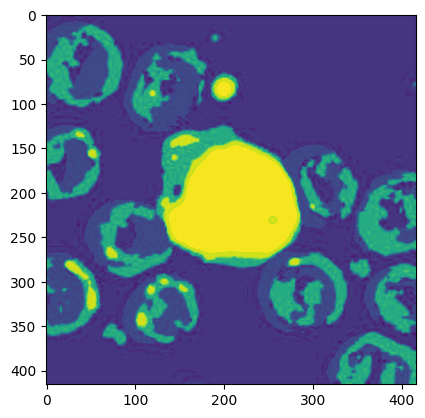

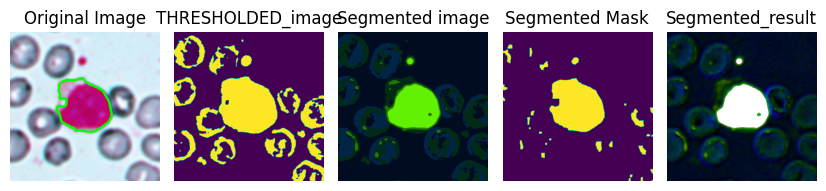

In [58]:
image = cv2.imread(
    "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\cropped_images8\\final_image27.jpg")
image_copy = image.copy()
# Define the RGB to CMYK conversion function


def bgr_to_cmyk(bgr):
    b, g, r = bgr/255.0
    b, g, r = b/255.0, g/255.0, r/255.0
    k = 1 - np.max([b, g, r])
    if k == 1:
        c = m = y = 0
    else:
        c = (1 - r - k) / (1 - k)
        m = (1 - g - k) / (1 - k)
        y = (1 - b - k) / (1 - k)
    return np.array([c, m, y, k])


def cmyk_to_bgr(cmyk):
    c, m, y, k = cv2.split(cmyk)
    r = 255 * (1 - (c * (1 - k) + k))
    g = 255 * (1 - (m * (1 - k) + k))
    b = 255 * (1 - (y * (1 - k) + k))
    return np.array([b, g, r], dtype=np.uint8)


# Apply the RGB to CMYK conversion to each pixel using a lambda function
cmyk_img = np.apply_along_axis(lambda x: bgr_to_cmyk(x), axis=2, arr=image)
cmyk_img_copy = cmyk_img.copy()
# plt.imshow(cmyk_img)
# Scale the values in the CMYK image to the range 0-255
cmyk_img = (cmyk_img*255).astype(np.uint8)

pixels = cmyk_img.reshape(-1, 4)
pixels = np.float32(pixels)
# Define the criteria for K-means clustering (maximum iterations and epsilon)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.9)

# Perform K-means clustering
k = 5  # Number of clusters
_, labels, centers = cv2.kmeans(
    pixels, k, None, criteria, 100, cv2.KMEANS_RANDOM_CENTERS)

# Convert the centers to unsigned integers
centers = np.uint8(centers)
# Map the labels to the centers
segmented_image = centers[labels.flatten()]

# Reshape the segmented image back to the original shape
segmented_image = segmented_image.reshape(cmyk_img.shape)
# plt.imshow(segmented_image)
print(segmented_image.shape)
cv2.imwrite("segmented_image.jpg", segmented_image)
# Apply the RGB to CMYK conversion to each pixel using a lambda function
bgr_img = cv2.imread("segmented_image.jpg")

# bgr_image = cv2.cvtColor(segmented_image, cv2.COLOR_CMYK2BGR)
# Scale the values in the CMYK image to the range 0-255
# bgr_image = (bgr_img*255).astype(np.uint8)
plt.imshow(bgr_img)
# Convert the segmented image to grayscale
segmented_HSV = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2HSV)
plt.imshow(segmented_HSV)
segmented_image_gray = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2GRAY)
# Set the threshold value (adjust as needed)
threshold = 150

_, segmented_mask = cv2.threshold(
    segmented_image_gray, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)
segmented_result = cv2.bitwise_and(
    cmyk_img_copy, cmyk_img_copy, mask=segmented_mask)
plt.imshow(segmented_mask)


def select_center_contour(contours):
    if len(contours) == 0:
        return None

    # Compute the areas of all contours
    contour_areas = [cv2.contourArea(contour) for contour in contours]

    # Find the index of the contour with the largest area
    max_area_index = np.argmax(contour_areas)

    # Return the contour with the largest area
    center_contour = contours[max_area_index]

    return center_contour


mask = np.zeros(segmented_mask.shape[:2], dtype="uint8")

contour_portion = cv2.bitwise_and(segmented_mask, segmented_mask, mask=mask)
segmented_copy = segmented_result.copy()


def select_center_contour(contours):
    if len(contours) == 0:
        return None

    # Compute the areas of all contours
    contour_areas = [cv2.contourArea(contour) for contour in contours]

    # Find the index of the contour with the largest area
    max_area_index = np.argmax(contour_areas)

    # Return the contour with the largest area
    center_contour = contours[max_area_index]

    return center_contour


def smooth_contour(contour, epsilon):
    # Convert the contour to a numpy array
    contour = np.squeeze(contour)

    # Reshape the contour to fit the required format for cv2.approxPolyDP
    contour = contour.reshape((-1, 1, 2))

    # Apply the Douglas-Peucker algorithm for contour approximation
    smoothed_contour = cv2.approxPolyDP(contour, epsilon, True)

    return smoothed_contour


L, A, B = cv2.split(segmented_HSV)
plt.imshow(L)
# Apply thresholding to the CLAHE transformed image
kernel = np.ones((3, 3), np.uint8)
_, thresholded_image = cv2.threshold(L, 30, 255, cv2.THRESH_BINARY)

# Define the kernel for erosion and dilation
kernel = np.ones((5, 5), np.uint8)
# cv2.drawContours(image_copy, contours, -1, (0, 255, 0), 2)
segmented_mask = cv2.erode(thresholded_image, kernel, iterations=2)
segmented_mask = cv2.morphologyEx(
    segmented_mask, cv2.MORPH_OPEN, kernel, iterations=1)


contours, _ = cv2.findContours(
    segmented_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
contours = select_center_contour(contours)
contour_areas = [cv2.contourArea(contour) for contour in contours]

# Find the index of the contour with the largest area
max_area_index = np.argmax(contour_areas)
# Choose the index of the contour you want to smoothen

# Set the epsilon value for contour smoothing (adjust as needed)
epsilon = 0.004 * cv2.arcLength(contours_cyto[max_area_index], True)
contours = smooth_contour(contours, epsilon)
cv2.drawContours(image_copy, [contours], -1, (0, 255, 0), 5)
histogram = cv2.calcHist([L], [0], None, [256], [0, 256])
# plt.imshow(histogram)

# Display the results
plt.figure(figsize=(10, 10))
plt.subplot(161)
plt.imshow(image_copy)
plt.title('Original Image')
plt.axis('off')

plt.subplot(162)
plt.imshow(thresholded_image)
plt.title('THRESHOLDED_image')
plt.axis('off')

plt.subplot(163)
plt.imshow(segmented_image)
plt.title('Segmented image')
plt.axis('off')

plt.subplot(164)
plt.imshow(segmented_mask)
plt.title('Segmented Mask')
plt.axis('off')

plt.subplot(165)
plt.imshow(segmented_result)
plt.title('Segmented_result')
plt.axis('off')
'''
plt.subplot(166)
plt.imshow(histogram)
plt.title('histogram')
plt.axis('off')
'''
plt.tight_layout()
plt.show()
# In this example, the K-means clustering algorithm is used to group similar colors in the image into clusters. The resulting segmented mask is obtained by thresholding the grayscale image, followed by morphological operations for cleaning up the mask. Finally, the segmented mask is applied to the original image to obtain the segmented result.

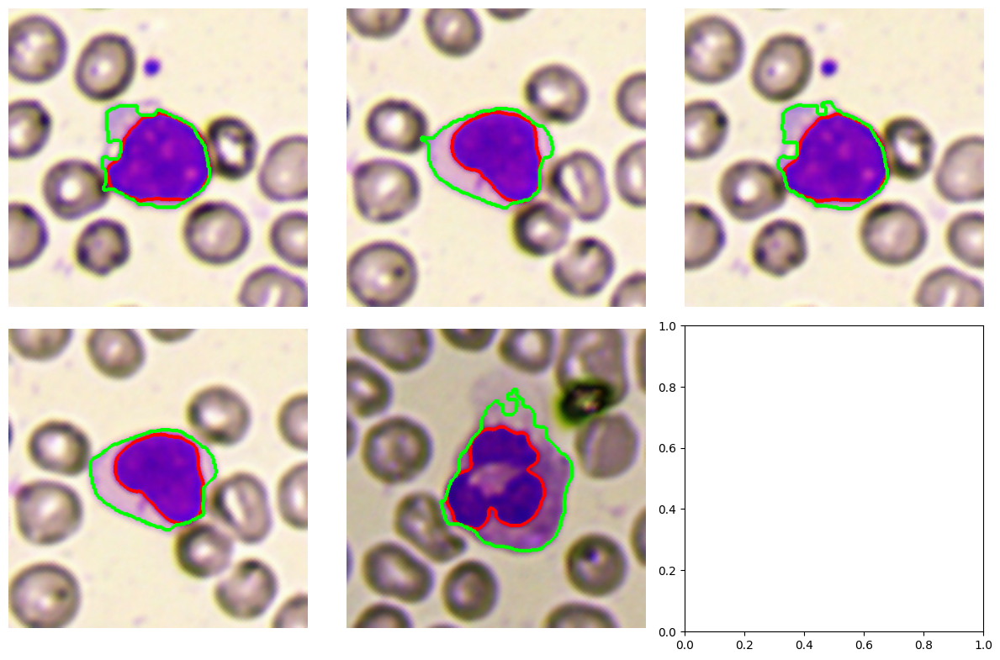

In [35]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

input_path = "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\Red_images_sample"

processed_image_red = []
Cyto_area = []
Cyto_Perimeter = []
# Iterate over the images in the folder
for filename in os.listdir(input_path):
    if filename.endswith(".jpg"):
        image_path = os.path.join(input_path, filename)

        # Read the image
        image = cv2.imread(image_path)
        image_copy = image.copy()
        # Define the RGB to CMYK conversion function

        def select_center_contour(contours):
            if len(contours) == 0:
                return None

            # Compute the areas of all contours
            contour_areas = [cv2.contourArea(contour) for contour in contours]

            # Find the index of the contour with the largest area
            max_area_index = np.argmax(contour_areas)

            # Return the contour with the largest area
            center_contour = contours[max_area_index]

            return center_contour

        def bgr_to_cmyk(bgr):
            b, g, r = bgr/255.0
            b, g, r = b/255.0, g/255.0, r/255.0
            k = 1 - np.max([b, g, r])
            if k == 1:
                c = m = y = 0
            else:
                c = (1 - r - k) / (1 - k)
                m = (1 - g - k) / (1 - k)
                y = (1 - b - k) / (1 - k)
            return np.array([c, m, y, k])

        def cmyk_to_bgr(cmyk):
            c, m, y, k = cv2.split(cmyk)
            r = 255 * (1 - (c * (1 - k) + k))
            g = 255 * (1 - (m * (1 - k) + k))
            b = 255 * (1 - (y * (1 - k) + k))
            return np.array([b, g, r], dtype=np.uint8)
        # Apply the RGB to CMYK conversion to each pixel using a lambda function
        cmyk_img = np.apply_along_axis(
            lambda x: bgr_to_cmyk(x), axis=2, arr=image)
        cmyk_img_copy = cmyk_img.copy()
        # plt.imshow(cmyk_img)
        # Scale the values in the CMYK image to the range 0-255
        cmyk_img = (cmyk_img*255).astype(np.uint8)

        pixels = cmyk_img.reshape(-1, 4)
        pixels = np.float32(pixels)
        # Define the criteria for K-means clustering (maximum iterations and epsilon)
        criteria = (cv2.TERM_CRITERIA_EPS +
                    cv2.TERM_CRITERIA_MAX_ITER, 100, 0.9)

        # Perform K-means clustering
        k = 5  # Number of clusters
        _, labels, centers = cv2.kmeans(
            pixels, k, None, criteria, 100, cv2.KMEANS_RANDOM_CENTERS)

        # Convert the centers to unsigned integers
        centers = np.uint8(centers)
        # Map the labels to the centers
        segmented_image = centers[labels.flatten()]

        # Reshape the segmented image back to the original shape
        segmented_image = segmented_image.reshape(cmyk_img.shape)
        # plt.imshow(segmented_image)
        # print(segmented_image.shape)
        cv2.imwrite("segmented_image.jpg", segmented_image)
        # Apply the RGB to CMYK conversion to each pixel using a lambda function
        bgr_img = cv2.imread("segmented_image.jpg")

        # bgr_image = cv2.cvtColor(segmented_image, cv2.COLOR_CMYK2BGR)
        # Scale the values in the CMYK image to the range 0-255
        # bgr_image = (bgr_img*255).astype(np.uint8)
        # plt.imshow(bgr_img)
        # Convert the segmented image to grayscale
        segmented_HSV = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2HSV)
        # plt.imshow(segmented_HSV)
        segmented_image_gray = cv2.cvtColor(
            segmented_image, cv2.COLOR_BGR2GRAY)
        # Set the threshold value (adjust as needed)

        _, segmented_mask = cv2.threshold(
            segmented_image_gray, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)
        # Invert the binary image using bitwise_not()
        inverted_image = cv2.bitwise_not(segmented_mask)
        contours, _ = cv2.findContours(
            inverted_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        contours = select_center_contour(contours)
        cv2.drawContours(image_copy, [contours], -1, (0, 0, 255), 3)
        segmented_result = cv2.bitwise_and(
            cmyk_img_copy, cmyk_img_copy, mask=segmented_mask)

        mask = np.zeros(segmented_mask.shape[:2], dtype="uint8")

        contour_portion = cv2.bitwise_and(
            segmented_mask, segmented_mask, mask=mask)
        segmented_copy = segmented_result.copy()

        def smooth_contour(contour, epsilon):
            # Convert the contour to a numpy array
            contour = np.squeeze(contour)

            # Reshape the contour to fit the required format for cv2.approxPolyDP
            contour = contour.reshape((-1, 1, 2))

            # Apply the Douglas-Peucker algorithm for contour approximation
            smoothed_contour = cv2.approxPolyDP(contour, epsilon, True)

            return smoothed_contour
        L, A, B = cv2.split(segmented_HSV)
        # plt.imshow(L)
        # Apply thresholding to the CLAHE transformed image
        kernel = np.ones((3, 3), np.uint8)
        _, thresholded_image = cv2.threshold(L, 30, 255, cv2.THRESH_BINARY)

        # Define the kernel for erosion and dilation
        kernel = np.ones((5, 5), np.uint8)
        # cv2.drawContours(image_copy, contours, -1, (0, 255, 0), 2)
        segmented_mask = cv2.erode(thresholded_image, kernel, iterations=2)
        segmented_mask = cv2.morphologyEx(
            segmented_mask, cv2.MORPH_OPEN, kernel, iterations=1)

        contours, _ = cv2.findContours(
            segmented_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        contours = select_center_contour(contours)
        contour_areas = [cv2.contourArea(contour) for contour in contours]

        # Find the index of the contour with the largest area
        max_area_index = np.argmax(contour_areas)
        # Choose the index of the contour you want to smoothen

        # Set the epsilon value for contour smoothing (adjust as needed)
        epsilon = 0.009 * cv2.arcLength(contours_cyto[max_area_index], True)
        contours = smooth_contour(contours, epsilon)
        # contours = cv2.convexHull(contours)
        cv2.drawContours(image_copy, [contours], -1, (0, 255, 0), 3)
        max_area_index = np.argmax(contour_areas)
        max_peri_index = np.argmax(contour_perimeter)
        area = contour_areas[max_area_index]
        '''peri = contour_perimeter[max_peri_index]
        Cyto_area.append(area)
        Cyto_Perimeter.append(peri)'''
        processed_image_red.append(image_copy)

# Create a grid for displaying the images
grid_rows = int(np.ceil(len(processed_image_red) / 3))
fig, axes = plt.subplots(grid_rows, 3, figsize=(12, 4 * grid_rows))

# Iterate over the processed images and display them in the grid
for i, image_x in enumerate(processed_image_red):
    row = i // 3
    col = i % 3
    axes[row, col].imshow(cv2.cvtColor(image_x, cv2.COLOR_BGR2RGB))
    axes[row, col].axis('off')

# Adjust the layout and display the grid
plt.tight_layout()
plt.show()

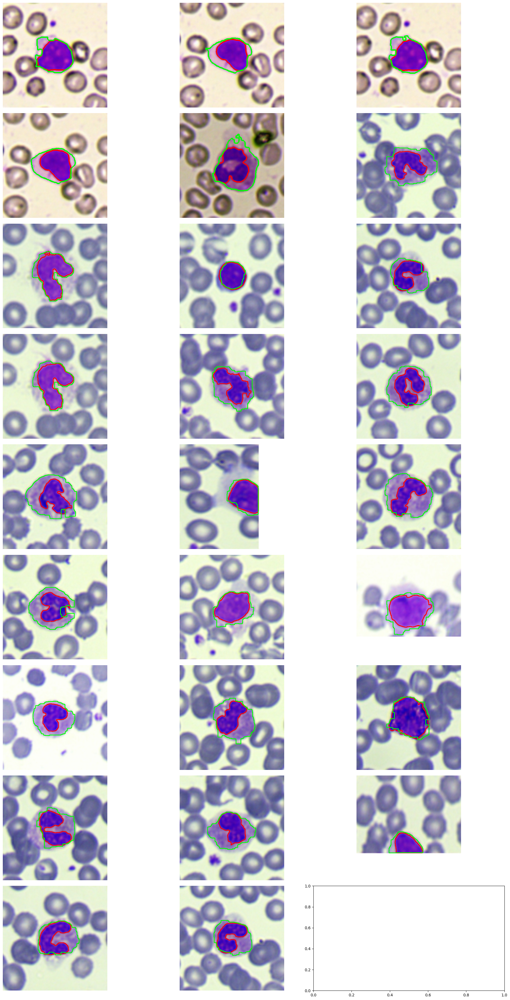

In [36]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

input_path = "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\blue_images_sample"

processed_image_blue = []
Cyto_area = []
Cyto_Perimeter = []
# Iterate over the images in the folder
for filename in os.listdir(input_path):
    if filename.endswith(".jpg"):
        image_path = os.path.join(input_path, filename)

       # Read the image
        image = cv2.imread(image_path)
        image_copy = image.copy()

        # plt.imshow(blurM)

        lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        img_hsv = cv2.cvtColor(lab, cv2.COLOR_BGR2HSV)

        # Define the lower and upper bounds for the green color in the HSV color space
        lower_green = np.array([40, 130, 170])
        upper_green = np.array([90, 255, 255])

        # Threshold the HSV image based on the color range
        img_mask = cv2.inRange(img_hsv, lower_green, upper_green)
        # plt.imshow(img_mask)
        # Find contours in the thresholded image
        contours, _ = cv2.findContours(
            img_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        def select_center_contour(contours):
            if len(contours) == 0:
                return None

            # Compute the areas of all contours
            contour_areas = [cv2.contourArea(contour) for contour in contours]

            # Find the index of the contour with the largest area
            max_area_index = np.argmax(contour_areas)

            # Return the contour with the largest area
            center_contour = contours[max_area_index]

            return center_contour
        nucleus_contour = select_center_contour(contours)
        cv2.drawContours(image_copy, [nucleus_contour], -1, (0, 0, 255), 2)

        # Draw the contours on the original image
        # cv2.drawContours(image_copy, contours, -1, (0, 255, 0), 2)
        # plt.subplot(144);plt.imshow(image_copy)
        # Display the final image in the corresponding grid cell
        pixels = image.reshape(-1, 3)
        pixels = np.float32(pixels)
        # Define the criteria for K-means clustering (maximum iterations and epsilon)
        criteria = (cv2.TERM_CRITERIA_EPS +
                    cv2.TERM_CRITERIA_MAX_ITER, 100, 0.5)

        # Perform K-means clustering
        k = 7  # Number of clusters
        _, labels, centers = cv2.kmeans(
            pixels, k, None, criteria, 100, cv2.KMEANS_RANDOM_CENTERS)

        # Convert the centers to unsigned integers
        centers = np.uint8(centers)
        # Map the labels to the centers
        segmented_image = centers[labels.flatten()]

        # Reshape the segmented image back to the original shape
        segmented_image = segmented_image.reshape(image.shape)

        # Convert the segmented image to grayscale
        segmented_image_gray = cv2.cvtColor(
            segmented_image, cv2.COLOR_RGB2GRAY)

        # Threshold the grayscale image
        _, segmented_mask = cv2.threshold(
            segmented_image_gray, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)

        # Apply the segmented mask to the original image
        segmented_result = cv2.bitwise_and(
            image_copy, image_copy, mask=segmented_mask)

        def smooth_contour(contour, epsilon):
            # Convert the contour to a numpy array
            contour = np.squeeze(contour)

            # Reshape the contour to fit the required format for cv2.approxPolyDP
            contour = contour.reshape((-1, 1, 2))

            # Apply the Douglas-Peucker algorithm for contour approximation
            smoothed_contour = cv2.approxPolyDP(contour, epsilon, True)

            return smoothed_contour
        mask = np.zeros(segmented_mask.shape[:2], dtype="uint8")
        segmented_copy = segmented_result.copy()
        # contours, _ = cv2.findContours(contour_portion,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        segmented_gray = cv2.cvtColor(segmented_result, cv2.COLOR_BGR2HSV)
        L, A, B = cv2.split(segmented_gray)
        kernel = np.ones((20, 10), np.uint8)
        _, thresholded_image = cv2.threshold(L, 128, 255, cv2.THRESH_BINARY)
        # Perform morphological closing to fill holes
        filled_image = cv2.morphologyEx(
            thresholded_image, cv2.MORPH_CLOSE, kernel)
        kernel = np.ones((15, 15), np.uint8)
        # Perform morphological opening to remove small dust particles
        opened_image = cv2.morphologyEx(filled_image, cv2.MORPH_OPEN, kernel)
        contours_cyto, _ = cv2.findContours(
            opened_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        # Select the center contour

        contour_areas = [cv2.contourArea(contour) for contour in contours_cyto]
        contour_perimeter = [cv2.arcLength(
            contour, True) for contour in contours_cyto]
        # Find the index of the contour with the largest area
        max_area_index = np.argmax(contour_areas)
        max_peri_index = np.argmax(contour_perimeter)
        area = contour_areas[max_area_index]
        peri = contour_perimeter[max_peri_index]
        # convex_cyto = cv2.convexHull(contours_cyto[max_area_index])
        Cyto_area.append(area)
        Cyto_Perimeter.append(peri)
        processed_image_blue.append(image_copy)
        cv2.drawContours(
            image_copy, [contours_cyto[max_area_index]], -1, (0, 255, 0), 2)
processed_image = processed_image_red + processed_image_blue
# Create a grid for displaying the images
grid_rows = int(np.ceil(len(processed_image) / 3))
fig, axes = plt.subplots(grid_rows, 3, figsize=(20, 4 * grid_rows))

# Iterate over the processed images and display them in the grid
for i, image_x in enumerate(processed_image):
    row = i // 3
    col = i % 3
    axes[row, col].imshow(cv2.cvtColor(image_x, cv2.COLOR_BGR2RGB))
    axes[row, col].axis('off')

# Adjust the layout and display the grid
plt.tight_layout()
plt.show()

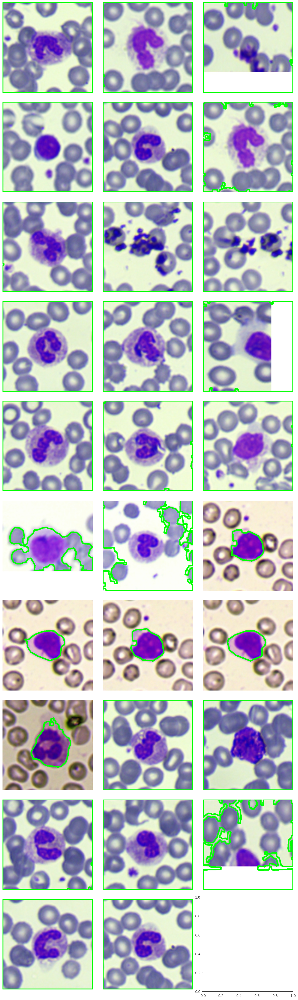

In [26]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

input_path = "C:\\Users\\krrah\\Downloads\\Dewinter2023\\Final_yolov5x\\cropped_images8"

processed_image = []
Cyto_area = []
Cyto_Perimeter = []
# Iterate over the images in the folder
for filename in os.listdir(input_path):
    if filename.endswith(".jpg"):
        image_path = os.path.join(input_path, filename)

        # Read the image
        image = cv2.imread(image_path)
        image_copy = image.copy()
        # Define the RGB to CMYK conversion function

        def bgr_to_cmyk(bgr):
            b, g, r = bgr/255.0
            b, g, r = b/255.0, g/255.0, r/255.0
            k = 1 - np.max([b, g, r])
            if k == 1:
                c = m = y = 0
            else:
                c = (1 - r - k) / (1 - k)
                m = (1 - g - k) / (1 - k)
                y = (1 - b - k) / (1 - k)
            return np.array([c, m, y, k])

        def cmyk_to_bgr(cmyk):
            c, m, y, k = cv2.split(cmyk)
            r = 255 * (1 - (c * (1 - k) + k))
            g = 255 * (1 - (m * (1 - k) + k))
            b = 255 * (1 - (y * (1 - k) + k))
            return np.array([b, g, r], dtype=np.uint8)
        # Apply the RGB to CMYK conversion to each pixel using a lambda function
        cmyk_img = np.apply_along_axis(
            lambda x: bgr_to_cmyk(x), axis=2, arr=image)
        cmyk_img_copy = cmyk_img.copy()
        # plt.imshow(cmyk_img)
        # Scale the values in the CMYK image to the range 0-255
        cmyk_img = (cmyk_img*255).astype(np.uint8)

        pixels = cmyk_img.reshape(-1, 4)
        pixels = np.float32(pixels)
        # Define the criteria for K-means clustering (maximum iterations and epsilon)
        criteria = (cv2.TERM_CRITERIA_EPS +
                    cv2.TERM_CRITERIA_MAX_ITER, 100, 0.9)

        # Perform K-means clustering
        k = 5  # Number of clusters
        _, labels, centers = cv2.kmeans(
            pixels, k, None, criteria, 100, cv2.KMEANS_RANDOM_CENTERS)

        # Convert the centers to unsigned integers
        centers = np.uint8(centers)
        # Map the labels to the centers
        segmented_image = centers[labels.flatten()]

        # Reshape the segmented image back to the original shape
        segmented_image = segmented_image.reshape(cmyk_img.shape)
        # plt.imshow(segmented_image)
        # print(segmented_image.shape)
        cv2.imwrite("segmented_image.jpg", segmented_image)
        # Apply the RGB to CMYK conversion to each pixel using a lambda function
        bgr_img = cv2.imread("segmented_image.jpg")

        # bgr_image = cv2.cvtColor(segmented_image, cv2.COLOR_CMYK2BGR)
        # Scale the values in the CMYK image to the range 0-255
        # bgr_image = (bgr_img*255).astype(np.uint8)
        # plt.imshow(bgr_img)
        # Convert the segmented image to grayscale
        segmented_HSV = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2HSV)
        # plt.imshow(segmented_HSV)
        segmented_image_gray = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2GRAY)
        # Set the threshold value (adjust as needed)
        threshold = 150

        _, segmented_mask = cv2.threshold(
            segmented_image_gray, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)
        segmented_result = cv2.bitwise_and(
            cmyk_img_copy, cmyk_img_copy, mask=segmented_mask)

        def select_center_contour(contours):
            if len(contours) == 0:
                return None

            # Compute the areas of all contours
            contour_areas = [cv2.contourArea(contour) for contour in contours]

            # Find the index of the contour with the largest area
            max_area_index = np.argmax(contour_areas)

            # Return the contour with the largest area
            center_contour = contours[max_area_index]

            return center_contour
        mask = np.zeros(segmented_mask.shape[:2], dtype="uint8")

        contour_portion = cv2.bitwise_and(
            segmented_mask, segmented_mask, mask=mask)
        segmented_copy = segmented_result.copy()

        def select_center_contour(contours):
            if len(contours) == 0:
                return None

            # Compute the areas of all contours
            contour_areas = [cv2.contourArea(contour) for contour in contours]

            # Find the index of the contour with the largest area
            max_area_index = np.argmax(contour_areas)

            # Return the contour with the largest area
            center_contour = contours[max_area_index]

            return center_contour

        def smooth_contour(contour, epsilon):
            # Convert the contour to a numpy array
            contour = np.squeeze(contour)

            # Reshape the contour to fit the required format for cv2.approxPolyDP
            contour = contour.reshape((-1, 1, 2))

            # Apply the Douglas-Peucker algorithm for contour approximation
            smoothed_contour = cv2.approxPolyDP(contour, epsilon, True)

            return smoothed_contour
        L, A, B = cv2.split(segmented_HSV)
        # plt.imshow(L)
        # Apply thresholding to the CLAHE transformed image
        kernel = np.ones((3, 3), np.uint8)
        _, thresholded_image = cv2.threshold(L, 30, 255, cv2.THRESH_BINARY)

        # Define the kernel for erosion and dilation
        kernel = np.ones((5, 5), np.uint8)
        # cv2.drawContours(image_copy, contours, -1, (0, 255, 0), 2)
        segmented_mask = cv2.erode(thresholded_image, kernel, iterations=2)
        segmented_mask = cv2.morphologyEx(
            segmented_mask, cv2.MORPH_OPEN, kernel, iterations=1)

        contours, _ = cv2.findContours(
            segmented_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        contours = select_center_contour(contours)
        contour_areas = [cv2.contourArea(contour) for contour in contours]

        # Find the index of the contour with the largest area
        max_area_index = np.argmax(contour_areas)
        # Choose the index of the contour you want to smoothen

        # Set the epsilon value for contour smoothing (adjust as needed)
        epsilon = 0.004 * cv2.arcLength(contours_cyto[max_area_index], True)
        contours = smooth_contour(contours, epsilon)
        cv2.drawContours(image_copy, [contours], -1, (0, 255, 0), 5)
        max_area_index = np.argmax(contour_areas)
        max_peri_index = np.argmax(contour_perimeter)
        area = contour_areas[max_area_index]
        '''peri = contour_perimeter[max_peri_index]
        Cyto_area.append(area)
        Cyto_Perimeter.append(peri)'''
        processed_image.append(image_copy)

# Create a grid for displaying the images
grid_rows = int(np.ceil(len(processed_image) / 3))
fig, axes = plt.subplots(grid_rows, 3, figsize=(12, 4 * grid_rows))

# Iterate over the processed images and display them in the grid
for i, image_x in enumerate(processed_image):
    row = i // 3
    col = i % 3
    axes[row, col].imshow(cv2.cvtColor(image_x, cv2.COLOR_BGR2RGB))
    axes[row, col].axis('off')

# Adjust the layout and display the grid
plt.tight_layout()
plt.show()